Random forest (RF) model for the image to image night vision CI problem.

**RF model:** 

*   Input: image patch of dimension rec x rec x 3 (rec stands for receptive field)
*   Ouput: True color RGB values of the central pixel (rec must be odd).

**Training and test:** 

During training we provide several patches cropped from the training set and the RF model is trained to predict the central pixel.

During test we divide the image into several patches. Applying the trained RF model on each patch we get a pixel of the output image. Combining all the pixels of the output image we reconstruct the output image.

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
%cd /gdrive

/gdrive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import ensemble
import itertools
from skimage.metrics import structural_similarity as ssim

In [ ]:
CloudTop = np.load("My Drive/DataChallengeCI2020/X_train_CI20.npy")
TrueColor = np.load("My Drive/DataChallengeCI2020/Y_train_CI20.npy")

In [ ]:
CloudTop_test = np.load("My Drive/DataChallengeCI2020/X_test_CI20_phase2.npy")

In [ ]:
import numpy as np
from sklearn import ensemble
import itertools

# Preprocessing. 
Naive way to remove images with black spots on the TrueColor side of the training set.

In [ ]:
def Cleanup_scale(Cloud_data, True_data, to_remove=0.975):
    """
    Input : 
    Cloud_data, True_data : the initial dataset
    to_remove : the percentage of pixels that we want larger than 0 in True_Data in order to keep the image in the training set 
    Output :
    cx, cy : The dataset used for training, with images with too much black removed . ( Note that np.delete does not 
    work in-place so the data-set is copied twice and the initial dataset it untouched)
    """

    tc1 = np.delete(True_data, np.where(np.count_nonzero(True_data, axis=(1,2,3))/ (127*127*3) < to_remove),0)
    ct1 = np.delete(Cloud_data, np.where(np.count_nonzero(True_data, axis=(1,2,3))/ (127*127*3) < to_remove),0)
    tc2 = np.delete(tc1, np.where(np.sum(ct1, axis=(1,2,3))==0.),0)
    ct2 = np.delete(ct1, np.where(np.sum(ct1, axis=(1,2,3))==0.),0)
    for i in range(tc2.shape[0]):
        ct2[i,:,:,:] = ct2[i,:,:,:]#/255
        tc2[i,:,:,:] = tc2[i,:,:,:]#/255
    return ct2, tc2
cx,cy  = Cleanup_scale(CloudTop, TrueColor)
print(cx.shape,cy.shape)
nimages=cx.shape[0]

(2854, 127, 127, 3) (2854, 127, 127, 3)


Here we build the arrays `input_rf` and `output_rf`, cropping the training images. These are the input patches and central output pixels of the RF model, respectively, during training. 

In [ ]:
# Parameters 
rec=15 # must be odd for the moment because we predict the central pixel
maxd=127//rec*rec
print('Chosen receptive field: ', rec, ' Used image: ',maxd)

# Building input design matrix
input_rf=[]
for i in range(rec):
    for j in range(rec):
        for ch in range(3):   
           input_rf.append(cx[:,i:maxd:rec,j:maxd:rec,ch].flatten())
input_rf=np.array(input_rf)
input_rf=np.transpose(input_rf)

# input_rf should be of shape n_samples x n_feat, where n_feat = rec * rec * 3
# ordering in the features should be i,j,ch where most internal index runs faster
print('INPUT_SHAPE: ', input_rf.shape)
print(input_rf[1,:])
print(cx[0,:5,5:10,:].flatten())

#Building output of regression
pix_output=int((rec-1)/2)
print('Position of pix_output: ',pix_output)
output_rf=[]
for ch in range(3):
    output_rf.append(cy[:,pix_output:maxd:rec,pix_output:maxd:rec,ch].flatten())
output_rf=np.array(output_rf)
output_rf=np.transpose(output_rf)
print('OUTPUT SHAPE: ',output_rf.shape)
n_feat=rec*rec*3
nsamples=output_rf.shape[0]

Chosen receptive field:  15  Used image:  120
INPUT_SHAPE:  (182656, 675)
[ 93.  44.  41. 108.  48.  44.  87.  43.  41.  77.  37.  36.  99.  46.
  44. 124.  73.  75. 104.  55.  54.  91.  44.  42.  79.  39.  38.  85.
  42.  41. 102.  77.  85.  76.  56.  62.  82.  70.  73.  95. 120. 124.
 105.  95.  96.  90.  48.  45.  96.  44.  41.  77.  39.  38.  85.  43.
  40.  75.  36.  36. 102.  45.  41. 103.  55.  54. 117.  71.  73. 103.
  58.  60.  94.  56.  57. 100.  72.  73.  72.  60.  65.  93.  92.  97.
  98.  93.  95. 101.  84.  86.  81.  49.  47.  94.  49.  46.  93.  56.
  55.  76.  39.  37.  75.  36.  35.  98.  50.  47. 109.  64.  61.  88.
  63.  62.  91.  45.  42.  69.  36.  35.  73.  44.  44.  90.  59.  60.
  87.  62.  62. 107.  71.  69. 101.  64.  63.  87.  57.  55.  87.  52.
  50. 104.  58.  55.  97.  54.  51.  96.  52.  50. 106.  58.  56. 106.
  57.  53.  78.  46.  45.  79.  41.  40.  92.  43.  40.  74.  37.  36.
  64.  32.  33.  68.  40.  41.  99.  75.  75. 116.  89.  89. 107.  75.
  7

# Tools to use the trained RF model for the night vision problem

In [ ]:
def predict_image(image,regressor,rec):
    """
    Function that uses a trained RF regressor to filter the image. It divides the input image
    into patches, applies the RF refressor, and than recombines the pixel in the output image.
    Input: 
    image: the CloudTop Image to be filtered, of dimension dim x dim x 3
    regressor: the RF model
    rec: the receptive field
    Output:
    output_image : the filtered image, of dimension dim-2*rec x dim-2*rec x 3 because no padding was made
    """
    d=int((rec-1)/2)
    dim=image.shape[0]
    inputs=[ image[i-d:i+d+1,j-d:j+d+1,:].flatten() for (i,j) in itertools.product(np.arange(d,dim-d),np.arange(d,dim-d)) ]
    # we crop the border for the moment.
    out_dim=dim-2*d
#    print(dim,d,out_dim)
#    print(np.array(inputs).shape)
    outputs=regressor.predict(np.array(inputs))
    output_image=np.zeros((out_dim,out_dim,3))
    for ch in range(3):
        output_image[:,:,ch]=outputs[:,ch].reshape((out_dim,out_dim))
    return output_image

Since function ´predict image´ crops the border, it returns a smaller image than the original one. 

To circumvent this, we first padd the input image and than apply ´predict image´.

Combining image -> padding_image -> predict_image -> output_image we obtain that the input and output image are of the same dimension.   

In [ ]:
def padding_image(image, rec):
    """
        Input: 
        image: the image to be padded, of dimension dim x dim x 3
        rec : the receptive field. In this case it says how much to padd the image
        Output:
        output_image : the padded image, of dimension dim+(rec-1) x dim+(rec-1) x 3 . The padding is made repeating the pixels 
        of the boarder twice.
    """   
    d=int((rec-1)/2)
    original_dim=image.shape[0]
    #padding original image
    padded_dim=original_dim+2*d
    padded_image=np.zeros((padded_dim,padded_dim,3))
    padded_image[d:d+original_dim,d:d+original_dim,:]=image[:,:,:]
    #vertical
    padded_image[:d,d:d+original_dim,:]=image[:d,:,:]
    padded_image[-d:,d:d+original_dim,:]=image[-d:,:,:]
    #horizontal
    padded_image[d:d+original_dim,:d,:]=image[:,:d,:]
    padded_image[d:d+original_dim,-d:,:]=image[:,-d:,:]
    #cornsers     
    padded_image[:d,:d,:]=image[:d,:d,:]
    padded_image[:d,-d:,:]=image[:d,-d:,:]
    padded_image[-d:,:d,:]=image[-d:,:d,:]
    padded_image[-d:,-d:,:]=image[-d:,-d:,:]

    return padded_image 

# RF model

In the RF model we use max_samples=20000 otherwise the input image patches are too many and do not fit into memory.

In [ ]:
regressor=ensemble.RandomForestRegressor(n_estimators=100, max_depth=400,max_samples=20000)
np.random.seed(23)
perm=np.random.permutation(nsamples)
regressor.fit(input_rf[perm][:],output_rf[perm][:])

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=400, max_features='auto', max_leaf_nodes=None,
                      max_samples=20000, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [ ]:
regressor=ensemble.RandomForestRegressor(n_estimators=100, max_depth=400,max_samples=20000)
np.random.seed(23)
perm=np.random.permutation(nsamples)
regressor.fit(input_rf[perm][:],output_rf[perm][:])

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=400, max_features='auto', max_leaf_nodes=None,
                      max_samples=20000, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

Visualizazion of three random images:

<Figure size 432x288 with 0 Axes>

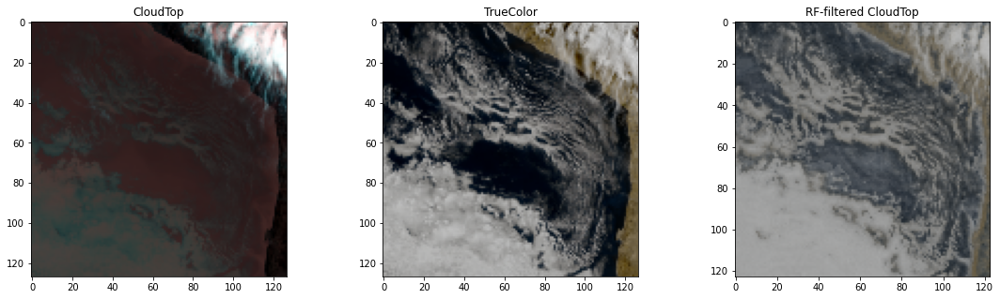

<Figure size 432x288 with 0 Axes>

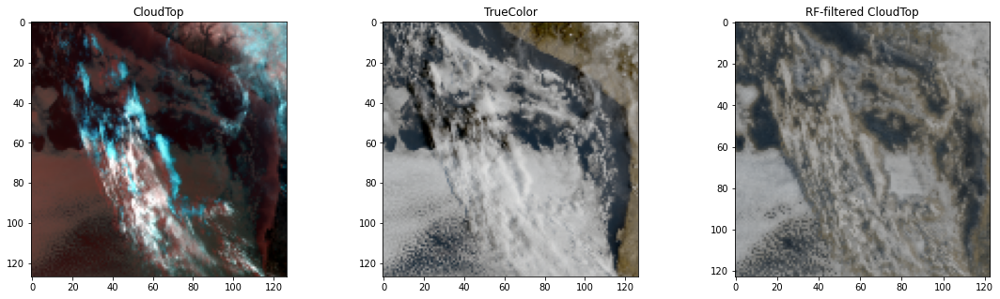

<Figure size 432x288 with 0 Axes>

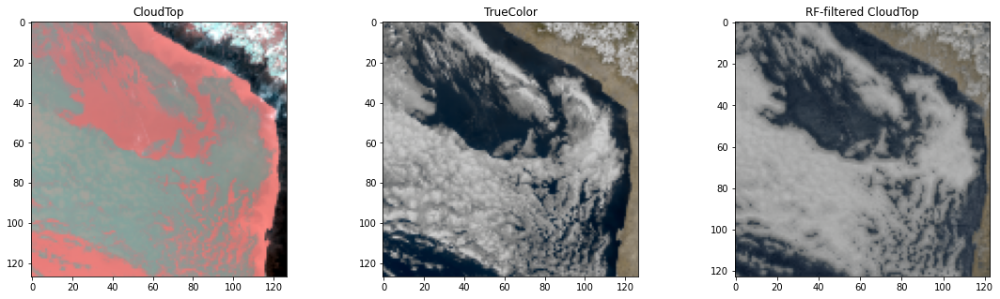

In [ ]:
for i in [12,323,424]:
# we retrieve d and do to crop the image to evaluate ssim
    d=int((rec-1)/2)
    dim=cx[i,:,:,:].shape[1]
    out_dim=dim-2*d
    plt.figure()
    fig, ax = plt.subplots(1, 3, figsize=(19,5))
    ax[0].set_title('CloudTop')
    ax[1].set_title('TrueColor')
    ax[2].set_title('RF-filtered CloudTop')
    ax[0].imshow(cx[i,:,:,:]/255)
    ax[1].imshow(cy[i,:,:,:]/255)
    predicted=predict_image(cx[i,:,:,:], regressor, rec)
    ax[2].imshow(predicted/255)

<Figure size 432x288 with 0 Axes>

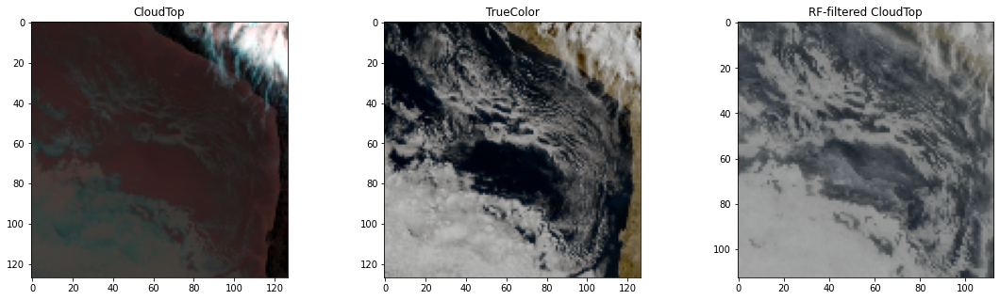

<Figure size 432x288 with 0 Axes>

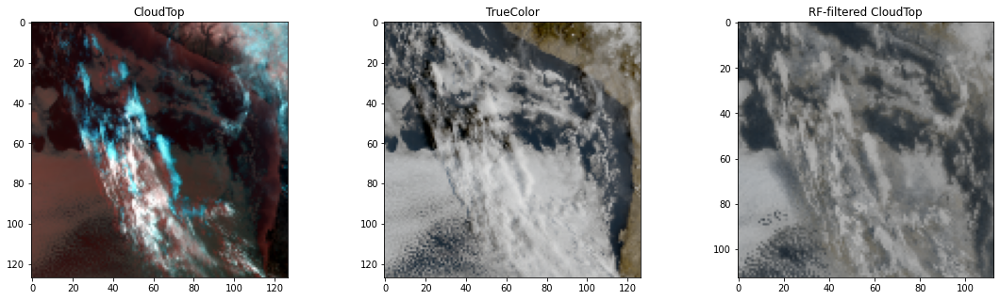

<Figure size 432x288 with 0 Axes>

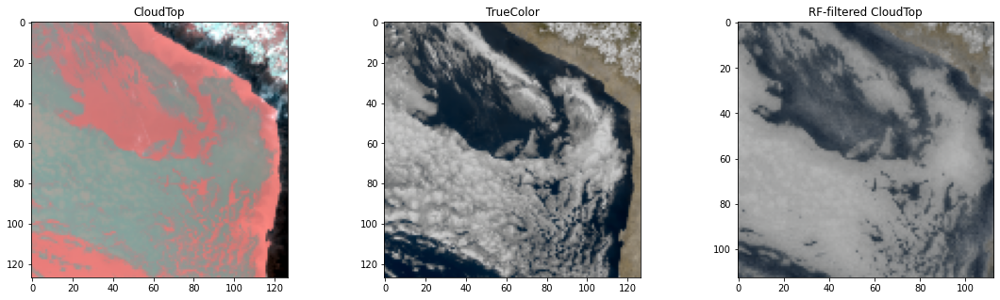

In [ ]:
for i in [12,323,424]:
# we retrieve d and do to crop the image to evaluate ssim
    d=int((rec-1)/2)
    dim=cx[i,:,:,:].shape[1]
    out_dim=dim-2*d
    plt.figure()
    fig, ax = plt.subplots(1, 3, figsize=(19,5))
    ax[0].set_title('CloudTop')
    ax[1].set_title('TrueColor')
    ax[2].set_title('RF-filtered CloudTop')
    ax[0].imshow(cx[i,:,:,:]/255)
    ax[1].imshow(cy[i,:,:,:]/255)
    predicted=predict_image(cx[i,:,:,:], regressor, rec)
    ax[2].imshow(predicted/255)

SSIM statistics for Random images of the training set and their distribution

In [ ]:
np.random.seed(323)
nchecks=300
d=int((rec-1)/2)
dim=cx[0,:,:,:].shape[0]
out_dim=dim-2*d
nimages=cx[:,:,:,:].shape[0]
lista=np.random.choice(nimages,300)
print(d,dim,out_dim,nimages)
results=[]
for n,i in enumerate(lista):
    predicted=predict_image(padding_image(cx[i,:,:,:],rec=rec), regressor, rec)
    sim=ssim(cx[i,:,:,:],predicted[:,:,:], gaussian_weights=True, multichannel=True, data_range=255)
    print(n,i,sim,' done')
    results.append(sim)

7 127 113 2854
0 48 0.5510942719268895  done
1 2348 0.44258050082009737  done
2 942 0.5619884564295101  done
3 740 0.511198153452026  done
4 1218 0.6875155781896661  done
5 563 0.6452912355562437  done
6 2030 0.6391483717702021  done
7 2743 0.6987831514670008  done
8 437 0.47634589071460987  done
9 1753 0.6652806004436357  done
10 2568 0.5354106879031294  done
11 2044 0.6593244069747258  done
12 2274 0.7568782188537394  done
13 301 0.40023960543219667  done
14 321 0.4542356449199507  done
15 1783 0.5252460351177192  done
16 384 0.6286652941242546  done
17 1312 0.5260994917183365  done
18 1524 0.6427459042603695  done
19 1668 0.7376477560367961  done
20 859 0.6033462845016478  done
21 2793 0.6026756747129548  done
22 463 0.4806793750354846  done
23 1332 0.5084805261259847  done
24 382 0.4091185214374631  done
25 2664 0.5171322559280465  done
26 605 0.49475822940371517  done
27 2515 0.698280247327372  done
28 2107 0.5468885421833423  done
29 1345 0.5990502703557272  done
30 281 0.5515236

Expected SSIM value:  0.5285618534463551


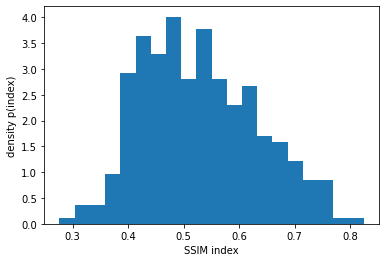

In [ ]:
plt.hist(results, bins=20, density=True)
plt.xlabel('SSIM index')
plt.ylabel('density p(index)')
print('Expected SSIM value: ', np.mean(np.array(results)))

Expected SSIM value:  0.5730262807929868


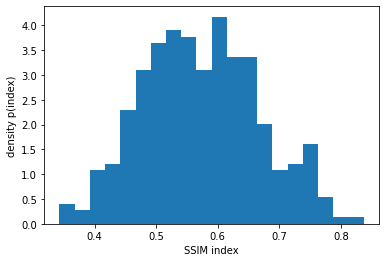

In [ ]:
plt.hist(results, bins=20, density=True)
plt.xlabel('SSIM index')
plt.ylabel('density p(index)')
print('Expected SSIM value: ', np.mean(np.array(results)))

# Submission to CodaCloud

In [ ]:
submit=np.zeros(CloudTop_test.shape)
for i in range(CloudTop_test.shape[0]):
    print(i)
    submit[i,:,:,:]=predict_image(padding_image(CloudTop_test[i,:,:,:],rec=rec), regressor, rec)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198


(199, 127, 127, 3)


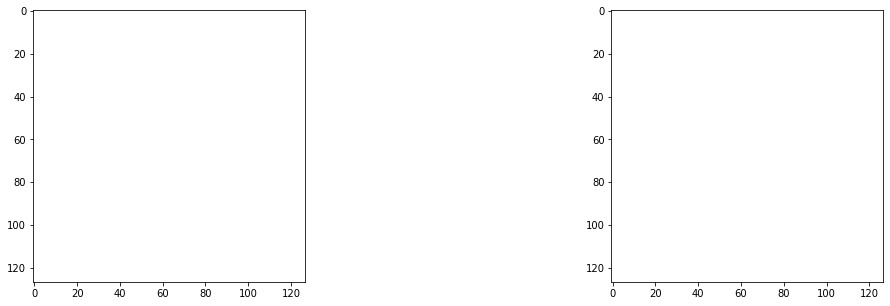

In [ ]:
import matplotlib.animation as animation
from matplotlib import rc

rc('animation', html='jshtml')
print(CloudTop_test.shape)

fig, axes = plt.subplots(1,2, figsize=(19,5))
ims = []

for i in range(0,submit.shape[0],1):
    im1 = axes[0].imshow(CloudTop_test[i,:,:,:]/255, animated=True)
    im2 = axes[1].imshow(submit[i,:,:,:]/255, animated=True)
    ims.append([im1, im2])

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True)
#ani.save("test_pred_naive-{:0.4f}.mp4".format(naive_score), dpi=300)

In [ ]:
ani

Animation size has reached 20985387 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
np.save("My Drive/DataChallengeCI2020/Y_test_CI20_phase2.npy",submit)

FINAL ACCURACY ON CODALAB FOR THE MOMENT : 0.51